<div class="alert alert-block alert-success">

# **1.** Import Libraries

<div>

In [6]:
import pandas as pd
import zipfile
import pickle
from sklearn.preprocessing import LabelEncoder
from pathlib import Path
from sklearn.model_selection import train_test_split
from tensorflow import keras
from keras import regularizers
from classes import *
from functions import *

In [7]:
import tensorflow as tf
from tensorflow.keras import models
from tensorflow.keras import layers
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Concatenate, Dropout, Input, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau
from keras.metrics import AUC, F1Score, CategoricalAccuracy, TopKCategoricalAccuracy
from sklearn.metrics import f1_score, precision_score, recall_score
from keras import optimizers

<div class="alert alert-block alert-success">

# **2.** Models Comparison

<div>

## 2.1 Models From Scratch

### GoogLeNet

#### Choose Best Model

In [ ]:
# Import the CSV file
summary_df = pd.read_csv("models_and_results/results/from_scratch/google_net_summary.csv", index_col=0)

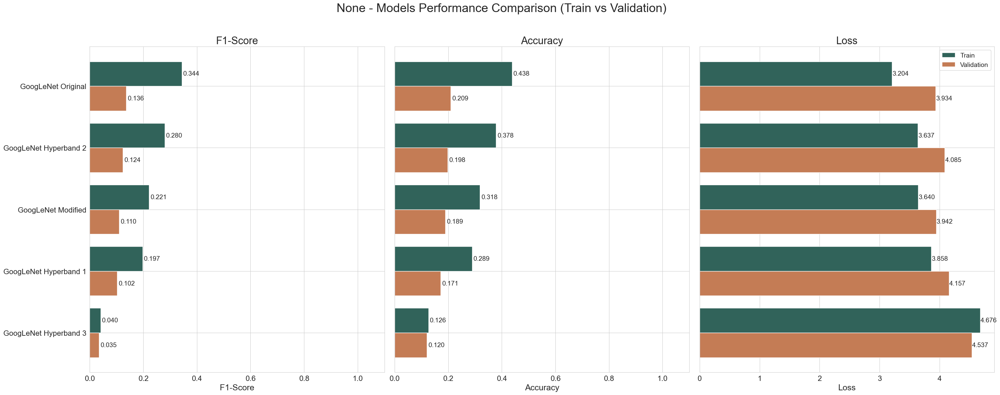

In [ ]:
plot_model_metrics(summary_df)

#### Initial vs Final Model Metrics Per Epoch

In [ ]:
# Define the root directory where all CSV files are stored
root_dir = "models_and_results/results/from_scratch/"

# Import the CSV file
initial_df = pd.read_csv(os.path.join(root_dir, "google_net_initial_history.csv"))
final_df = pd.read_csv(os.path.join(root_dir, "google_net_final_history.csv"))

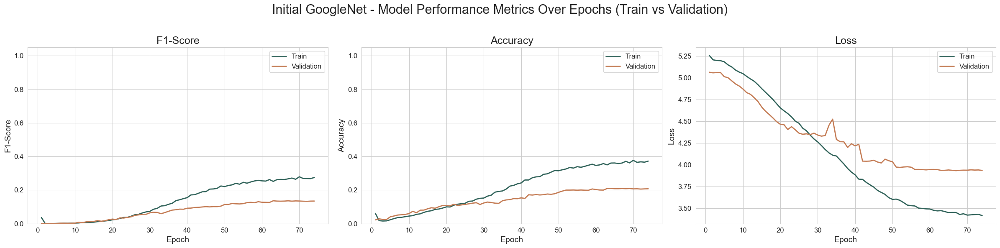

In [ ]:
plot_training_history(initial_df, title_model="Initial GoogleNet")

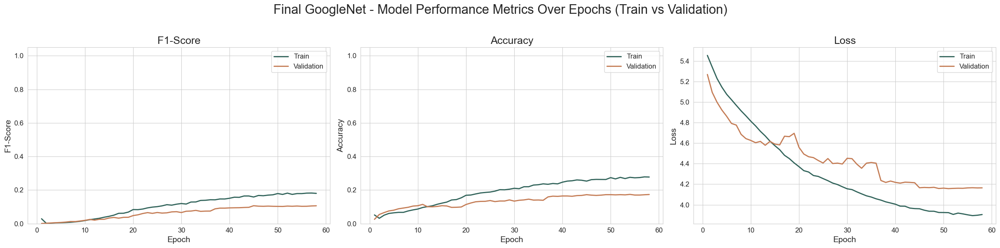

In [ ]:
plot_training_history(final_df, title_model="Final GoogleNet")

### DenseNet121

#### Choose Best Model

In [ ]:
# Import the CSV file
summary_df = pd.read_csv("models_and_results/results/from_scratch/dense_net_summary.csv", index_col=0)

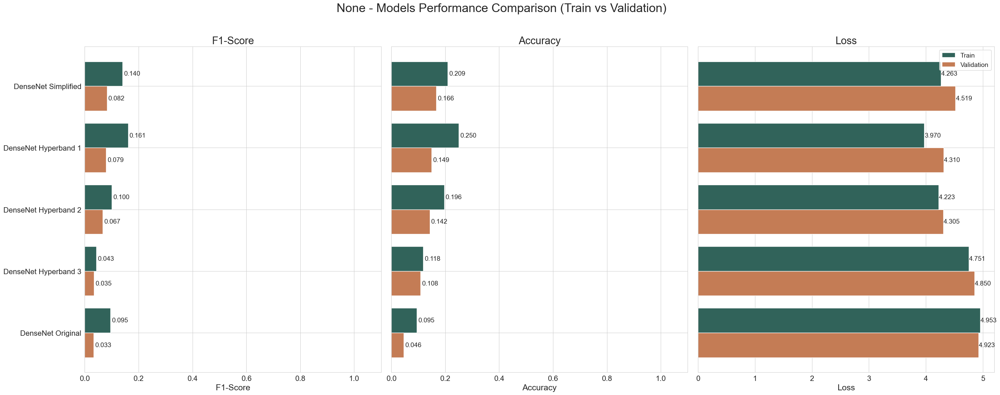

In [ ]:
plot_model_metrics(summary_df)

#### Initial vs Final Model Metrics Per Epoch

In [ ]:
# Define the root directory where all CSV files are stored
root_dir = "models_and_results/results/from_scratch/"

# Import the CSV file
initial_df = pd.read_csv(os.path.join(root_dir, "dense_net_initial_history.csv"))
final_df = pd.read_csv(os.path.join(root_dir, "dense_net_final_history.csv"))

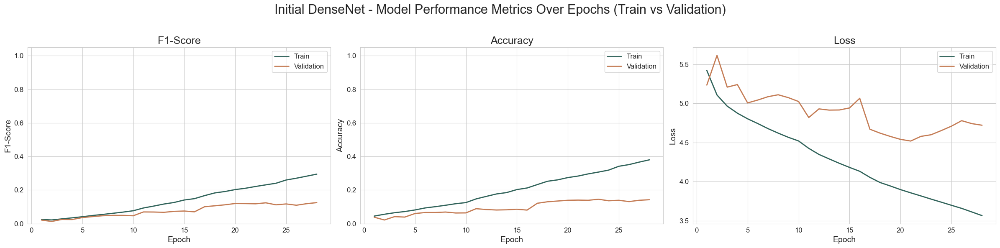

In [ ]:
plot_training_history(initial_df, title_model="Initial DenseNet")

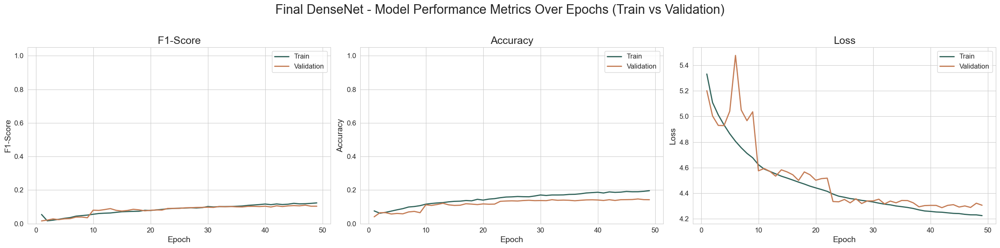

In [ ]:
plot_training_history(final_df, title_model="Final DenseNet")

### ResNet18

#### Choose Best Model

In [ ]:
# Import the CSV file
summary_df = pd.read_csv("models_and_results/results/from_scratch/res_net_summary.csv", index_col=0)

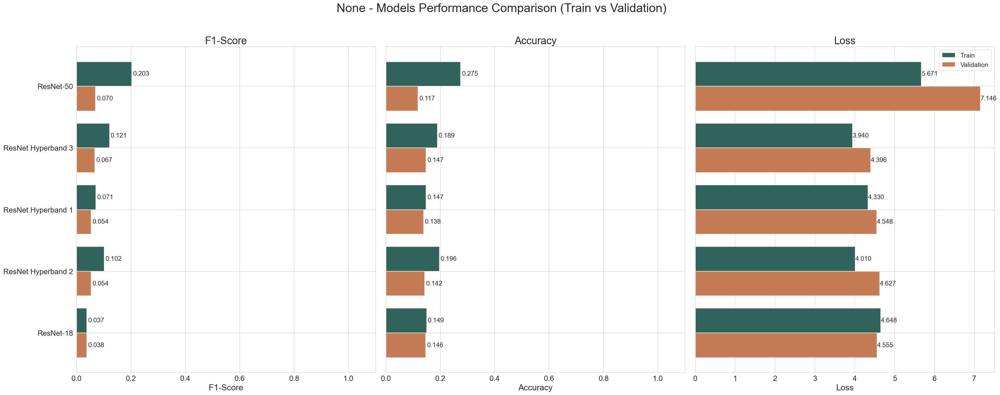

In [ ]:
plot_model_metrics(summary_df)

#### Initial vs Final Model Metrics Per Epoch

In [ ]:
# Define the root directory where all CSV files are stored
root_dir = "models_and_results/results/from_scratch/"

# Import the CSV file
initial_df = pd.read_csv(os.path.join(root_dir, "res_net_initial_history.csv"))
# final_df = pd.read_csv(os.path.join(root_dir, "res_net_final_history.csv"))

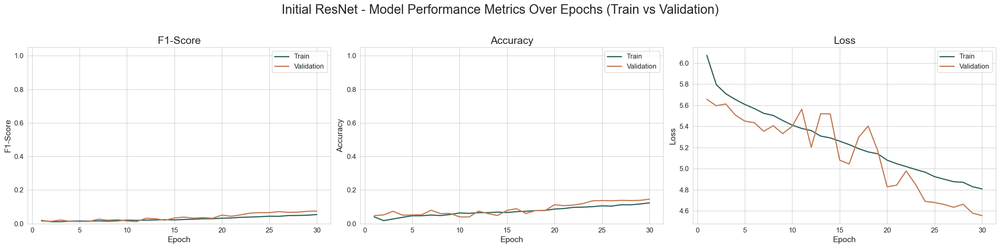

In [ ]:
plot_training_history(initial_df, title_model="Initial ResNet")

## 2.2 Pre-trained EfficientNetB0 without Phylum

In [ ]:
# Define the root directory where all CSV files are stored
root_dir = "models_and_results/results/pre-trained_no_phylum"

# Define the files with relative paths
files = {
    "VGG16": os.path.join(root_dir, "vgg_history_train_until_opt.csv"),
    "ResNet50": os.path.join(root_dir, "resnet50_final_train_history.csv"),
    "EfficientNetB0 Baseline 1": os.path.join(root_dir, "efficient_net_baseline1_history.csv"),
    "EfficientNetB0 Baseline 2": os.path.join(root_dir, "efficient_net_baseline2_history.csv"),
    "EfficientNetB0 Before Fine-Tune": os.path.join(root_dir, "efficient_net_final_train_history.csv"),
    "EfficientNetB0 Fine-Tuned": os.path.join(root_dir, "efficient_net_final_finetune_history.csv"),
}

In [ ]:
summary_df = create_model_summary_df(files)
summary_df

,Train Accuracy,Validation Accuracy,Train F1-Score,Validation F1-Score,Train Loss,Validation Loss
Model,,,,,,
EfficientNetB0 Fine-Tuned,0.733482,0.700612,0.736858,0.677013,1.344867,1.513090
EfficientNetB0 Baseline 1,0.920720,0.708959,0.923846,0.667322,0.414008,1.149756
EfficientNetB0 Before Fine-Tune,0.716607,0.686700,0.717598,0.660923,1.406863,1.542795
EfficientNetB0 Baseline 2,0.706366,0.657763,0.666257,0.591676,1.428393,1.591309
ResNet50,0.633125,0.608236,0.625082,0.556639,1.710753,1.883143
VGG16,0.538839,0.554814,0.494909,0.501549,2.305127,2.251417


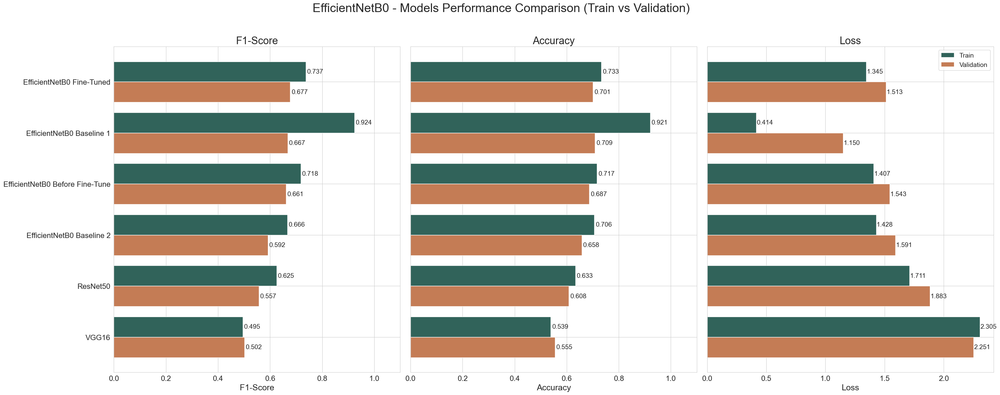

In [ ]:
plot_model_metrics(summary_df, title_model="EfficientNetB0")

## 2.3 Pre-trained EfficientNetB0 with Phylum

In [ ]:
# Define the root directory where all CSV files are stored
root_dir = "models_and_results/results/pre-trained_phylum"

# Define the files with relative paths
files = {
    "EfficientNetB0 w/Phylum Baseline 1": os.path.join(root_dir, "efficient_net_phylum_1_no_proc_no_reg_history.csv"),
    "ResNetEfficientNetB0 w/Phylum Baseline 2": os.path.join(root_dir, "efficient_net_phylum_2_no_proc_reg_history.csv"),
    "EfficientNetB0 w/Phylum Before Fine-Tune": os.path.join(root_dir, "efficient_net_phylum_3_pre_ft_history.csv"),
    "EfficientNetB0 w/Phylum Fine-Tuned": os.path.join(root_dir, "efficient_net_phylum_4_ft_history.csv"),
}

In [ ]:
summary_df = create_model_summary_df(files)
summary_df

,Train Accuracy,Validation Accuracy,Train F1-Score,Validation F1-Score,Train Loss,Validation Loss
Model,,,,,,
EfficientNetB0 w/Phylum Fine-Tuned,0.6964,0.6667,0.6950,0.6209,1.4667,1.6233
EfficientNetB0 w/Phylum Before Fine-Tune,0.6413,0.6461,0.6324,0.5961,1.6352,1.6921
ResNetEfficientNetB0 w/Phylum Baseline 2,0.6829,0.6539,0.6421,0.5800,1.4866,1.6197
EfficientNetB0 w/Phylum Baseline 1,0.6631,0.5977,0.5887,0.4966,1.5212,1.7217


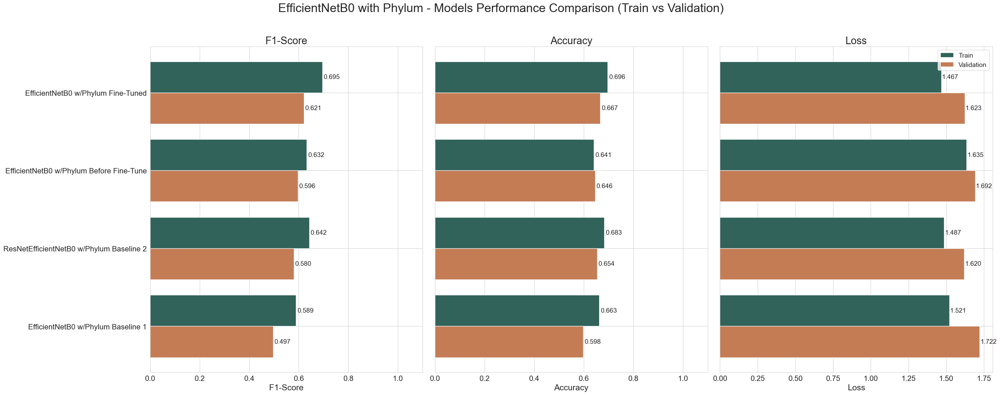

In [ ]:
plot_model_metrics(summary_df, title_model="EfficientNetB0 with Phylum")

## 2.4 Pre-trained EfficientNetB0 without Phylum without Outliers

In [ ]:
# Define the root directory where all CSV files are stored
root_dir = "models_and_results/results/pre-trained_no_phylum_no_outliers/"

# Define the files with relative paths
files = {
    "All Fine Tune": os.path.join(root_dir, "efficient_net_final_without_outliers_all_finetune_history.csv"),
    "All Before Fine Tune": os.path.join(root_dir, "efficient_net_final_without_outliers_all_train_history.csv"),
    "Misclassified Fine Tune": os.path.join(root_dir, "efficient_net_final_without_outliers_finetune_history.csv"),
    "Misclassified Before Fine Tune": os.path.join(root_dir, "efficient_net_final_without_outliers_train_history.csv"),
}

In [ ]:
summary_df = create_model_summary_df(files)
summary_df

,Train Accuracy,Validation Accuracy,Train F1-Score,Validation F1-Score,Train Loss,Validation Loss
Model,,,,,,
Misclassified Fine Tune,0.739399,0.690039,0.743414,0.655489,1.338020,1.541555
All Fine Tune,0.747748,0.692821,0.748861,0.654693,1.302281,1.541790
All Before Fine Tune,0.721378,0.680579,0.718699,0.643141,1.381631,1.573125
Misclassified Before Fine Tune,0.717920,0.679466,0.715404,0.640639,1.408023,1.568748


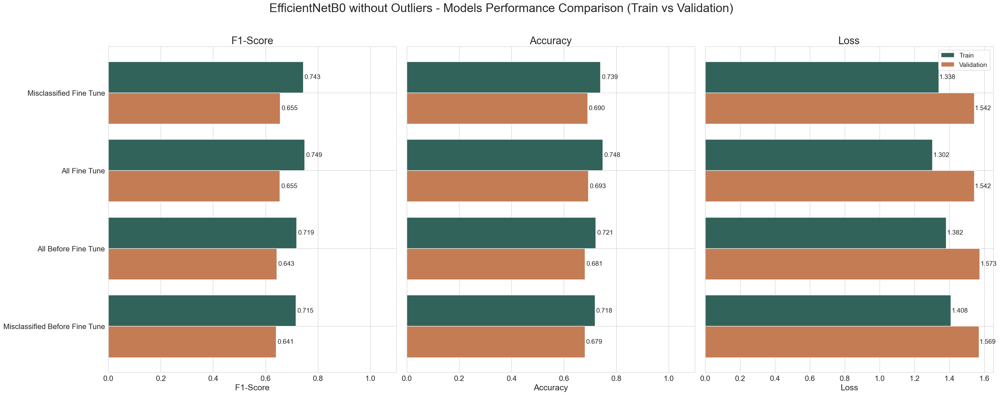

In [ ]:
plot_model_metrics(summary_df, title_model="EfficientNetB0 without Outliers")

<div class="alert alert-block alert-success">

# **3.** Preprocessing

<div>

In [10]:
#Load the DataFrames from the .pkl files
with open("../data/train_df.pkl", "rb") as f:
     train_df = pickle.load(f)

with open("../data/val_df.pkl", "rb") as f:
     val_df = pickle.load(f)

with open("../data/test_df.pkl", "rb") as f:
     test_df = pickle.load(f)

with open("family_encoder.pkl", "rb") as f:
     family_encoder = pickle.load(f)

with open("phylum_encoder.pkl", "rb") as f:
     phylum_encoder = pickle.load(f)

In [11]:
# identify the minority class
minority_class = train_df['family'].value_counts()[train_df['family'].value_counts() < 25].index
minority_class = minority_class.to_list()

In [12]:
batch_size = 32 ## the less the better because in each epoch the model sees N / batch_size images
image_size = (224, 224)

preprocess = Preprocessor(image_size=image_size, batch_size=batch_size)

2025-05-01 22:05:56.620861: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M3
2025-05-01 22:05:56.620909: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2025-05-01 22:05:56.620918: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2025-05-01 22:05:56.620951: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-05-01 22:05:56.620977: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [13]:
# num_images = 16 ##
# rows, cols = 4, 4 ##

# plot_batch(train_ds, class_names=class_names, num_images=num_images, rows=rows, cols=cols)

<div class="alert alert-block alert-success">

# **4.** Final Model - Error Analysis

<div>

In [14]:
# Load model keras
model = load_model("efficient_net_finetuned_final.keras")

/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 34 variables whereas the saved optimizer has 6 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [15]:
# load datasets
train_ds, class_names = preprocess.load_img(
    data_dir="../data/rare_species/train",
    minority_class=minority_class,
    augment='mixup',
    oversampling=True,
    shuffle=True,
    preprocessing_function=preprocess_input)

test_ds, _ = preprocess.load_img(
    data_dir="../data/rare_species/test",
    minority_class=[],
    augment=None,
    shuffle= False,
    preprocessing_function=preprocess_input)

Found 8388 files belonging to 202 classes.
Found 1798 files belonging to 202 classes.


In [16]:
# Load encoder
import pickle

with open('family_encoder.pkl', 'rb') as f:
    family_encoder = pickle.load(f)

# Load class names
class_names = family_encoder.classes_

class_names

array(['accipitridae', 'acipenseridae', 'acroporidae', 'agamidae',
       'agariciidae', 'albulidae', 'alcedinidae', 'alligatoridae',
       'alopiidae', 'ambystomatidae', 'anatidae', 'anguidae', 'aotidae',
       'apidae', 'ardeidae', 'arthroleptidae', 'atelidae', 'attelabidae',
       'balaenicipitidae', 'balaenidae', 'balaenopteridae', 'balistidae',
       'bombycillidae', 'bovidae', 'brachypteraciidae', 'bucerotidae',
       'bufonidae', 'burhinidae', 'cacatuidae', 'callitrichidae',
       'callorhinchidae', 'caprimulgidae', 'carabidae', 'carcharhinidae',
       'cardiidae', 'carettochelyidae', 'cebidae', 'cerambycidae',
       'cercopithecidae', 'cervidae', 'cetorhinidae', 'chaetodontidae',
       'chamaeleonidae', 'charadriidae', 'cheirogaleidae', 'chelidae',
       'cheloniidae', 'chelydridae', 'ciconiidae', 'coenagrionidae',
       'colubridae', 'columbidae', 'conidae', 'cracidae', 'cricetidae',
       'crocodylidae', 'cryptobranchidae', 'ctenomyidae', 'cuculidae',
       'cypr

#### Incorporate phylum

In [76]:
# Unbatch test_ds into list
test_images = []
test_labels = []

for img, label in test_ds.unbatch():
    test_images.append(img.numpy())
    test_labels.append(label.numpy())

test_images = np.array(test_images)
test_labels = np.array(test_labels)

# Predict all test images
pred_probs_all = model.predict(test_images, verbose=1)
y_pred = np.argmax(pred_probs_all, axis=1)
y_true = test_labels

2025-05-01 22:20:15.112659: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


57/57 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step


In [77]:
# create family:phylum dicionary
meta = pd.read_csv('../data/rare_species/metadata.csv')
dup = meta.groupby('family')['phylum'].nunique()
family_to_phylum = dict(zip(meta['family'], meta['phylum']))

In [78]:
# --- 2) Prepare true labels & names ---
# labels: your true labels, shape (11200,) or one-hot (11200,202)
# class_names: list of length 202 mapping index→family string
labels = np.argmax(test_labels, axis=1) # family# prediction, not one-hot-encoded
y_true_fam   = np.array([class_names[i] for i in labels])
y_true_phyl  = np.array([family_to_phylum[f] for f in y_true_fam])

In [79]:
# --- 3) Baseline predictions & phylum check ---
y_pred       = np.argmax(pred_probs_all, axis=1)
y_pred_fam   = np.array([class_names[i] for i in y_pred])
y_pred_phyl  = np.array([family_to_phylum[f] for f in y_pred_fam])

In [80]:
# a dictionary phylum:[list of indices of classes that belong to that phylum]
phylum_to_inds = {}
for idx, fam in enumerate(class_names):
    ph = family_to_phylum[fam]
    phylum_to_inds.setdefault(ph, []).append(idx)


In [81]:
# --- 4) Hierarchical override logic ---
y_pred_hier = y_pred.copy()
for i, probs in enumerate(pred_probs_all):
    # if predicted phylum ≠ true phylum, force to best within true phylum
    if y_pred_phyl[i] != y_true_phyl[i]:
        valid_idx = phylum_to_inds[y_true_phyl[i]]
        y_pred_hier[i] = valid_idx[np.argmax(probs[valid_idx])]



In [82]:
y_true_labels = np.argmax(y_true, axis=1)

In [83]:
# --- 5) Overall accuracy comparison ---
acc_base  = accuracy_score(labels, y_pred)
acc_hier  = accuracy_score(labels, y_pred_hier)
print(f"Baseline overall accuracy:     {acc_base:.4f}")
print(f"Hierarchical override accuracy:{acc_hier:.4f}")

Baseline overall accuracy:     0.7019
Hierarchical override accuracy:0.7147


In [84]:
print("Classification report with original predictions:")
print(classification_report(labels,y_pred_hier,digits=4))

Classification report with original predictions:
              precision    recall  f1-score   support

           0     0.7143    0.8333    0.7692        18
           1     0.7333    0.7857    0.7586        14
           2     0.6889    0.9688    0.8052        32
           3     0.2500    0.1111    0.1538         9
           4     0.5556    0.5556    0.5556        18
           5     0.2500    0.2500    0.2500         4
           6     1.0000    0.6000    0.7500         5
           7     0.3333    0.2500    0.2857         4
           8     1.0000    0.3333    0.5000         9
           9     1.0000    0.1111    0.2000         9
          10     0.6250    0.7407    0.6780        27
          11     0.7273    0.8889    0.8000         9
          12     1.0000    0.4444    0.6154         9
          13     1.0000    0.9565    0.9778        23
          14     0.5833    0.7778    0.6667         9
          15     1.0000    0.4000    0.5714         5
          16     0.6957    0.695

/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWar

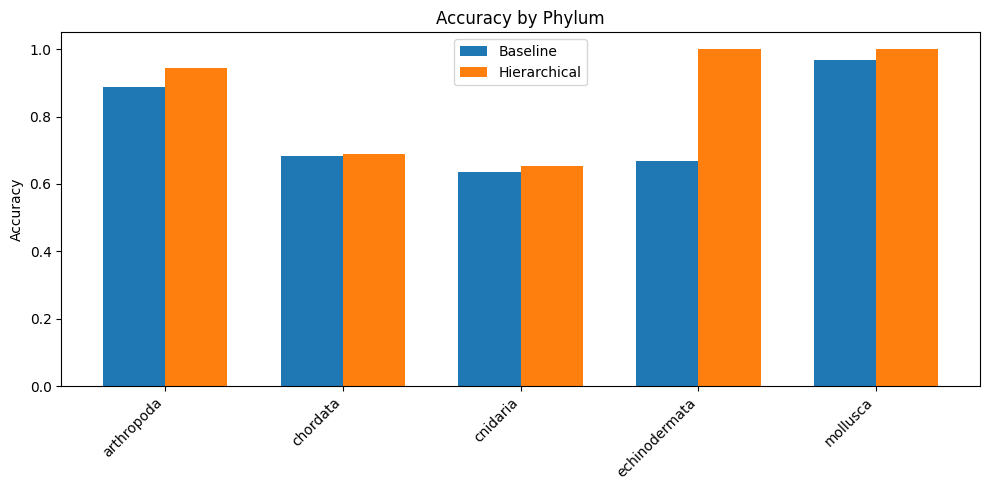

In [85]:
# --- 6) Per-phylum accuracy improvement ---
phyla = np.unique(y_true_phyl)
base_scores = []
hier_scores = []
for ph in phyla:
    idxs = np.where(y_true_phyl == ph)[0]
    base_scores.append( accuracy_score(labels[idxs], y_pred[idxs]) )
    hier_scores.append( accuracy_score(labels[idxs], y_pred_hier[idxs]) )

x = np.arange(len(phyla))
width = 0.35

plt.figure(figsize=(10,5))
plt.bar(x - width/2, base_scores, width, label='Baseline')
plt.bar(x + width/2, hier_scores, width, label='Hierarchical')
plt.xticks(x, phyla, rotation=45, ha='right')
plt.ylabel('Accuracy')
plt.title('Accuracy by Phylum')
plt.legend()
plt.tight_layout()
plt.show()


### Confusion matrix

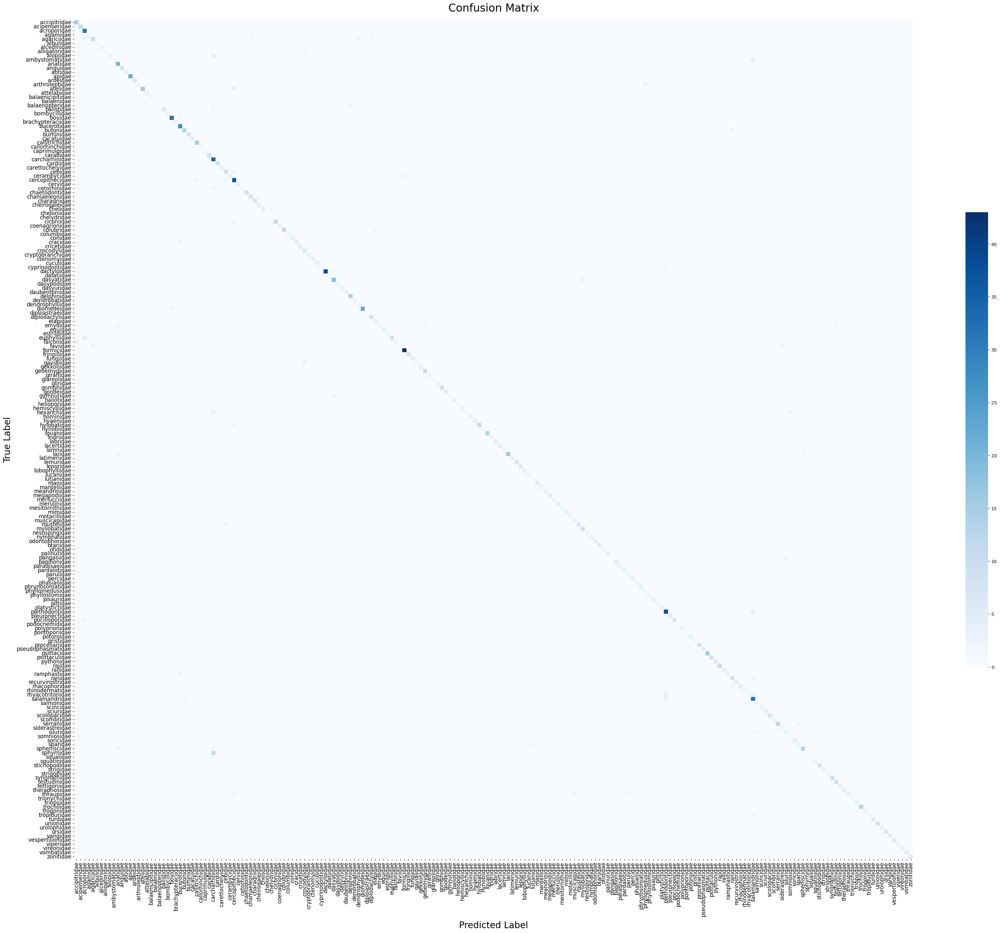

In [86]:
# Example usage with y_true, y_pred_hier, and class_names
plot_confusion_matrix(y_true_labels, y_pred_hier, class_names, figsize=(35, 30), fontsize=12, title="Confusion Matrix")

### F1-Score and Support per Class

In [89]:
# Confusion matrix
cm = confusion_matrix(y_true_labels, y_pred_hier)

# Classification report for precision, recall, f1
report = classification_report(y_true_labels, y_pred_hier, target_names=class_names, output_dict=True)

# Extract per-class F1-scores and supports
class_f1 = {}
supports = {}

for cls in class_names:
    f1 = report[cls]['f1-score']
    support = report[cls]['support']
    class_f1[cls] = f1
    supports[cls] = support

# Sort classes by F1-score
asc_sorted_classes = sorted(class_f1.items(), key=lambda x: x[1])  # ascending
dsc_sorted_classes = sorted(class_f1.items(), key=lambda x: x[1], reverse=True)  # descending

/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWar

In [90]:
top_n = 10

# Best classified classes
best_classes = {
    'Class': [],
    'F1-Score': [],
    'Support': []
}

for cls, f1 in dsc_sorted_classes[:top_n]:
    best_classes['Class'].append(cls)
    best_classes['F1-Score'].append(round(f1, 4))
    best_classes['Support'].append(round(supports[cls], 4))

best_df = pd.DataFrame(best_classes)

# Worst classified classes
worst_classes = {
    'Class': [],
    'F1-Score': [],
    'Support': []
}

for cls, f1 in asc_sorted_classes[:top_n]:
    worst_classes['Class'].append(cls)
    worst_classes['F1-Score'].append(round(f1, 4))
    worst_classes['Support'].append(round(supports[cls], 4))

worst_df = pd.DataFrame(worst_classes)

# Display them
print("\nBest Classified Classes:")
display(best_df)

print("\nWorst Classified Classes:")
display(worst_df)


Best Classified Classes:


,Class,F1-Score,Support
0,attelabidae,1.0,4.0
1,cacatuidae,1.0,4.0
2,carabidae,1.0,9.0
3,cardiidae,1.0,9.0
4,cervidae,1.0,4.0
5,chaetodontidae,1.0,9.0
6,conidae,1.0,4.0
7,cricetidae,1.0,5.0
8,ctenomyidae,1.0,4.0
9,daubentoniidae,1.0,4.0



Worst Classified Classes:


,Class,F1-Score,Support
0,balaenopteridae,0.0000,5.0
1,cheloniidae,0.0000,4.0
2,chelydridae,0.0000,4.0
3,pangasiidae,0.0000,5.0
4,squalidae,0.0000,5.0
5,sphyrnidae,0.1111,14.0
6,agamidae,0.1538,9.0
7,faviidae,0.1538,9.0
8,hexanchidae,0.1818,9.0
9,ambystomatidae,0.2000,9.0


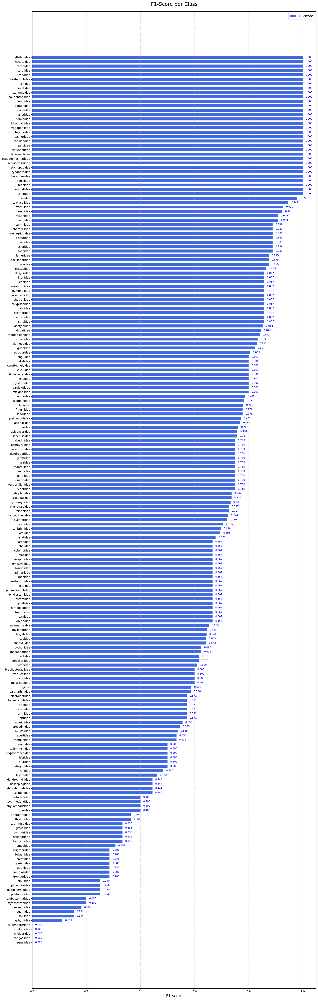

In [91]:
# Prepare data sorted descending by F1
classes = [cls for cls, _ in dsc_sorted_classes]
f1_scores = [round(class_f1[cls], 4) for cls in classes]

# Settings
fig, ax = plt.subplots(figsize=(16, 50))  # Big figure to fit all classes

y_pos = np.arange(len(classes)) * 1.5  # Space between bars
bar_width = 1.0  # Wider bars

# Plot F1 bars
f1_bars = ax.barh(y_pos, f1_scores, height=bar_width, color='royalblue', label='F1-score')

# Labels
ax.set_yticks(y_pos)
ax.set_yticklabels(classes, fontsize=10)  # Bigger class labels
ax.invert_yaxis()  # Best F1 on top
ax.set_xlabel('F1-score', fontsize=14)
ax.set_xlim(0, 1.05)
ax.set_title('F1-Score per Class', fontsize=18, pad=20)
ax.legend(fontsize=12)

# Grid
plt.grid(axis='x', linestyle='--', alpha=0.6)

# Add value labels to bars
for bar in f1_bars:
    width = bar.get_width()
    ax.text(width + 0.01, bar.get_y() + bar.get_height()/2, f'{width:.3f}', 
            va='center', ha='left', fontsize=9, color='blue')

# Adjust layout
plt.subplots_adjust(top=0.98, bottom=0.02)
plt.tight_layout()
plt.show()

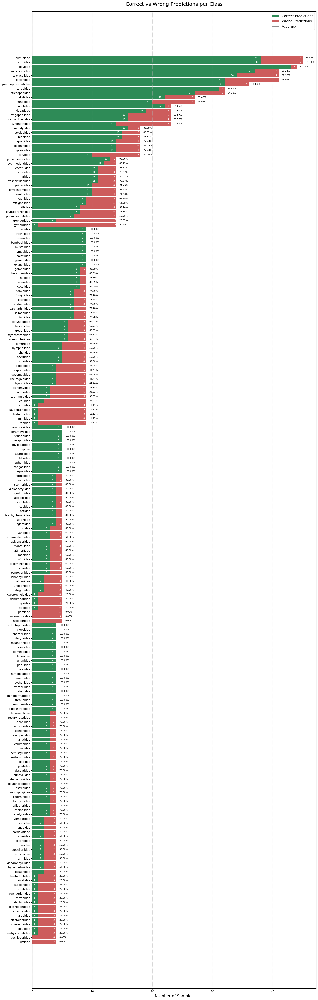

In [92]:
import numpy as np
import matplotlib.pyplot as plt

# Calculate correct and wrong per class
correct_counts = []
wrong_counts = []
total_counts = []
accuracies = []  # To store accuracies

for i, cls in enumerate(classes):
    correct = cm[i, i]  # True Positives for class i
    total = cm[i].sum()  # Total actual samples of class i
    wrong = total - correct
    accuracy = correct / total * 100 if total > 0 else 0  # Avoid division by zero
    correct_counts.append(correct)
    wrong_counts.append(wrong)
    total_counts.append(total)
    accuracies.append(accuracy)

# Sort classes
sorted_classes = sorted(
    zip(classes, correct_counts, wrong_counts, total_counts, accuracies),
    key=lambda x: (x[3], x[1]),  # Sort by total then correct
    reverse=True
)

# Unzip sorted
classes_sorted, correct_counts_sorted, wrong_counts_sorted, total_counts_sorted, accuracies_sorted = zip(*sorted_classes)

# Settings
fig, ax = plt.subplots(figsize=(16, 50))  # Tall for many classes
y_pos = np.arange(len(classes_sorted))
bar_width = 0.9

# Bars
correct_bars = ax.barh(y_pos, correct_counts_sorted, height=bar_width, color='seagreen', label='Correct Predictions')
wrong_bars = ax.barh(y_pos, wrong_counts_sorted, left=correct_counts_sorted, height=bar_width, color='indianred', label='Wrong Predictions')

# Labels
ax.set_yticks(y_pos)
ax.set_yticklabels(classes_sorted, fontsize=10)
ax.invert_yaxis()
ax.set_xlabel('Number of Samples', fontsize=14)
ax.set_title('Correct vs Wrong Predictions per Class', fontsize=18, pad=20)

# Value labels
fixed_spacing = 0.5
for bar1, bar2, accuracy in zip(correct_bars, wrong_bars, accuracies_sorted):
    width1 = bar1.get_width()
    width2 = bar2.get_width()
    if width1 > 0:
        ax.text(width1 - fixed_spacing, bar1.get_y() + bar1.get_height()/2, int(width1), va='center', ha='right', fontsize=8, color='white')
    if width2 > 0:
        ax.text(width1 + width2 - fixed_spacing, bar2.get_y() + bar2.get_height()/2, int(width2), va='center', ha='left', fontsize=8, color='white')
    ax.text(width1 + width2 + fixed_spacing, bar1.get_y() + bar1.get_height()/2, f"{accuracy:.2f}%", va='center', ha='left', fontsize=8, color='black')

# Grid
ax.grid(axis='x', linestyle='--', alpha=0.5)

# Legend
handles, labels = ax.get_legend_handles_labels()
accuracy_patch = plt.Line2D([0], [0], color='gray', lw=2, label='Accuracy')
handles.append(accuracy_patch)
labels.append('Accuracy')
ax.legend(handles=handles, labels=labels, fontsize=12)

# Layout
plt.subplots_adjust(top=0.98, bottom=0.02)
plt.tight_layout()
plt.show()

### Visualize high confidence images

#### Top Missclassified

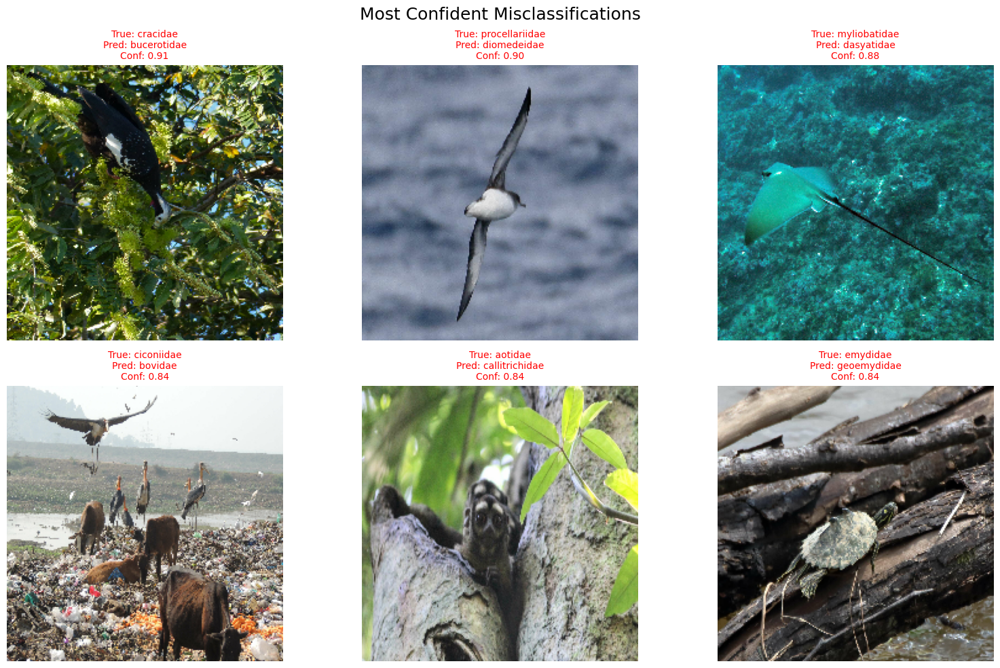

In [93]:
# Get misclassified indices
misclassified_indices = np.where(y_true_labels != y_pred)[0]

# For each misclassified, get model confidence (highest softmax probability)
confidences = np.max(pred_probs_all[misclassified_indices], axis=1)

# Sort misclassified examples by descending confidence
sorted_indices = np.argsort(confidences)[::-1]  # Sort descending
selected_indices = misclassified_indices[sorted_indices[:6]]  # Take top 6

# Prepare images to show (selected misclassified ones)
images_to_show = []

for idx in selected_indices:
    img = test_images[idx]
    true_label = y_true_labels[idx]
    pred_label = y_pred[idx]
    confidence = confidences[np.where(misclassified_indices == idx)][0]  # Get confidence for the current misclassified image
    images_to_show.append((img, true_label, pred_label, confidence))

# Save the misclassified data
misclassified_data = {
    "True Label": [class_names[true_label] for _, true_label, _, _ in images_to_show],
    "Predicted Label": [class_names[pred_label] for _, _, pred_label, _ in images_to_show],
    "Confidence": [confidence for _, _, _, confidence in images_to_show]
}

# Plot
plt.figure(figsize=(16, 10))

for i, (img, true_label, pred_label, confidence) in enumerate(images_to_show):
    plt.subplot(2, 3, i + 1)
    plt.imshow(img.astype("uint8"))
    plt.axis('off')
    plt.title(f"True: {class_names[true_label]}\nPred: {class_names[pred_label]}\nConf: {confidence:.2f}", 
              color='red', fontsize=10)

plt.suptitle("Most Confident Misclassifications", fontsize=18)
plt.tight_layout()
plt.show()

In [94]:
misclassified_data

{'True Label': ['cracidae',
  'procellariidae',
  'myliobatidae',
  'ciconiidae',
  'aotidae',
  'emydidae'],
 'Predicted Label': ['bucerotidae',
  'diomedeidae',
  'dasyatidae',
  'bovidae',
  'callitrichidae',
  'geoemydidae'],
 'Confidence': [0.9054435,
  0.90354866,
  0.8809782,
  0.84396374,
  0.84111935,
  0.8403583]}

#### Top Correctly Classified

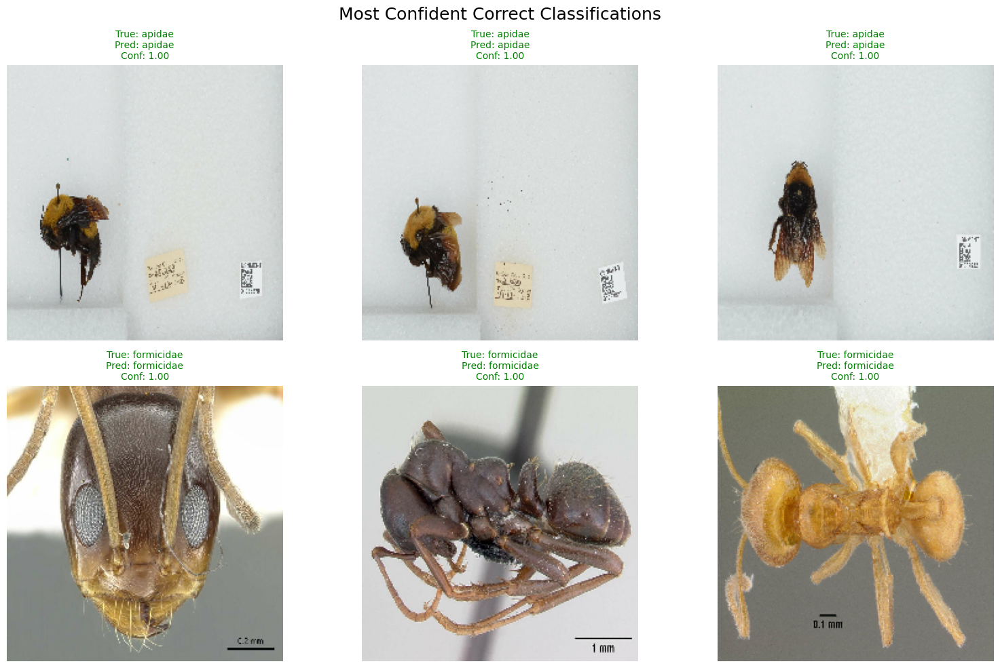

In [95]:
# Get indices of correctly classified images
correct_indices = np.where(y_true_labels == y_pred)[0]

# For each correctly classified image, get model confidence (highest softmax probability)
confidences = np.max(pred_probs_all[correct_indices], axis=1)

# Sort correctly classified examples by descending confidence
sorted_indices = np.argsort(confidences)[::-1]  # Sort descending
selected_indices = correct_indices[sorted_indices[:6]]  # Take top 6 with highest confidence

# Prepare images to show (selected correctly classified ones)
images_to_show = []

for idx in selected_indices:
    img = test_images[idx]
    true_label = y_true_labels[idx]
    pred_label = y_pred[idx]
    confidence = confidences[np.where(correct_indices == idx)][0]  # Get confidence for the current correctly classified image
    images_to_show.append((img, true_label, pred_label, confidence))

# Save the misclassified data
correctly_classified_data = {
    "True Label": [class_names[true_label] for _, true_label, _, _ in images_to_show],
    "Predicted Label": [class_names[pred_label] for _, _, pred_label, _ in images_to_show],
    "Confidence": [confidence for _, _, _, confidence in images_to_show]
}

# Plot
plt.figure(figsize=(16, 10))

for i, (img, true_label, pred_label, confidence) in enumerate(images_to_show):
    plt.subplot(2, 3, i + 1)
    plt.imshow(img.astype("uint8"))
    plt.axis('off')
    plt.title(f"True: {class_names[true_label]}\nPred: {class_names[pred_label]}\nConf: {confidence:.2f}", 
              color='green', fontsize=10)

plt.suptitle("Most Confident Correct Classifications", fontsize=18)
plt.tight_layout()
plt.show()

In [96]:
correctly_classified_data

{'True Label': ['apidae',
  'apidae',
  'apidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Predicted Label': ['apidae',
  'apidae',
  'apidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Confidence': [0.9996068,
  0.9995665,
  0.9995208,
  0.9994623,
  0.9994497,
  0.9993734]}

#### Correctly Classified for Specific Class

In [97]:
misclassified_data

{'True Label': ['cracidae',
  'procellariidae',
  'myliobatidae',
  'ciconiidae',
  'aotidae',
  'emydidae'],
 'Predicted Label': ['bucerotidae',
  'diomedeidae',
  'dasyatidae',
  'bovidae',
  'callitrichidae',
  'geoemydidae'],
 'Confidence': [0.9054435,
  0.90354866,
  0.8809782,
  0.84396374,
  0.84111935,
  0.8403583]}

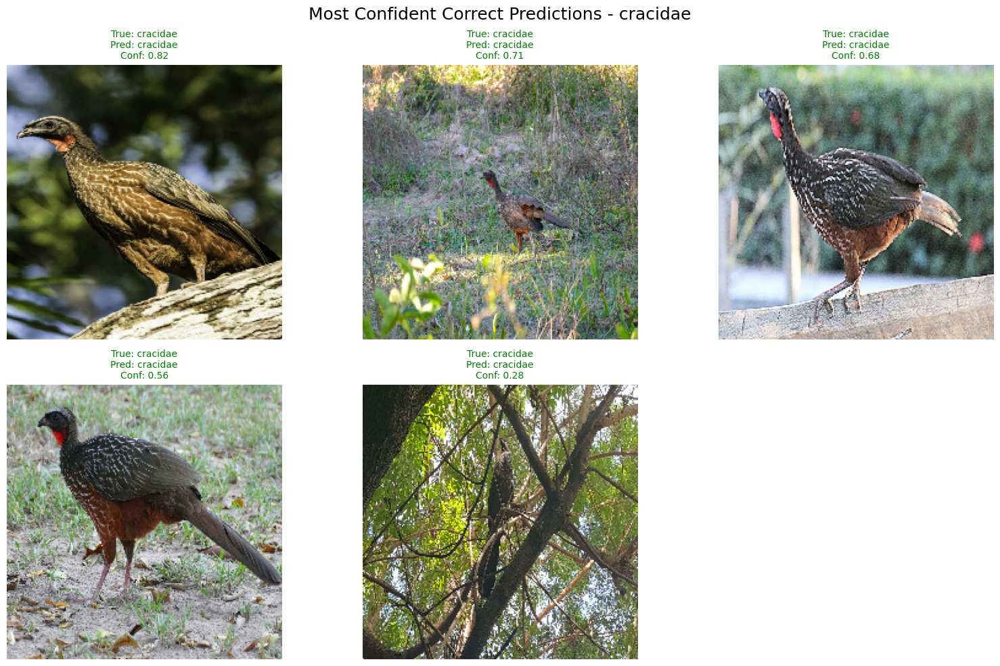

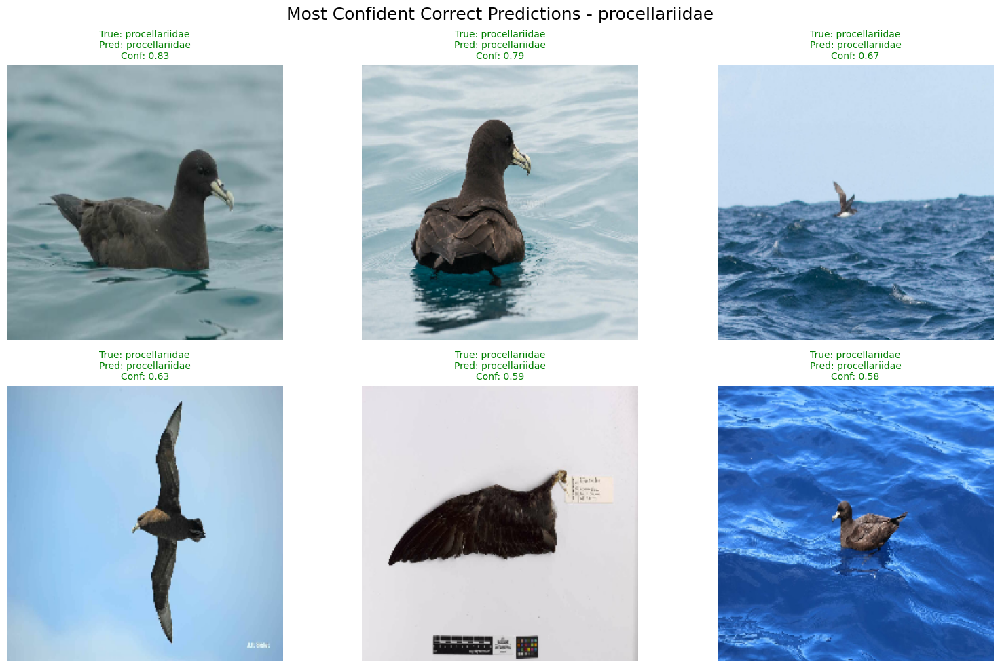

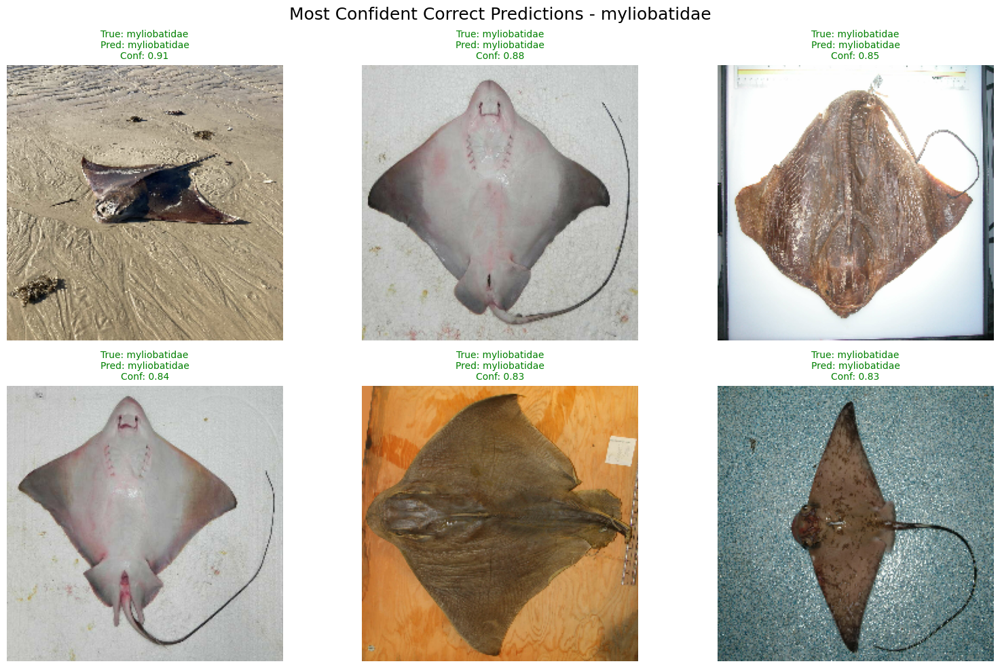

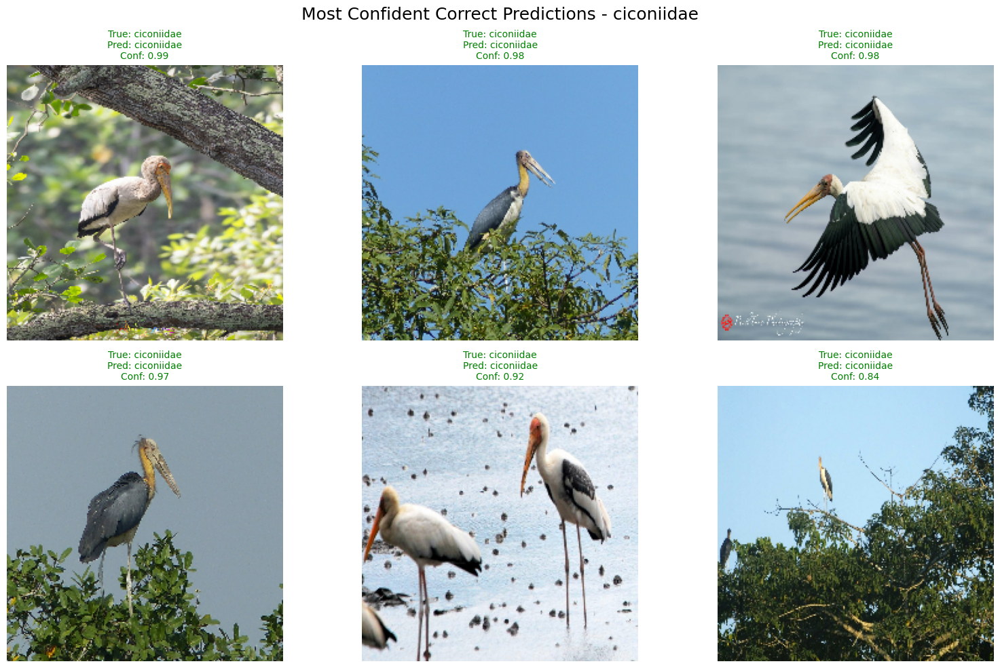

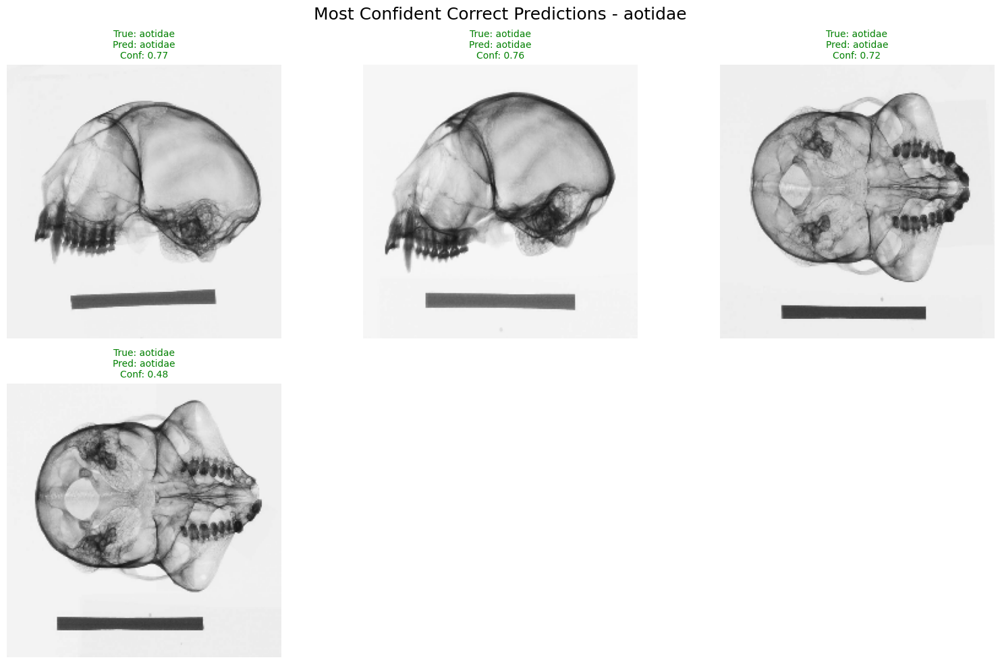

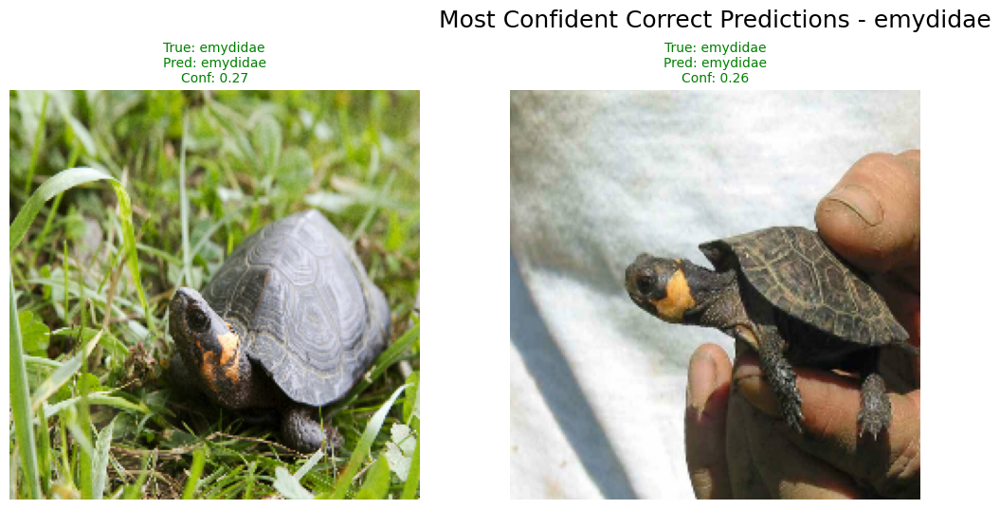

In [98]:
for family in misclassified_data["True Label"]:
    show_correct_predictions_for_family(y_true, y_pred, pred_probs_all, test_images, class_names, family_name=family, num_images=6)

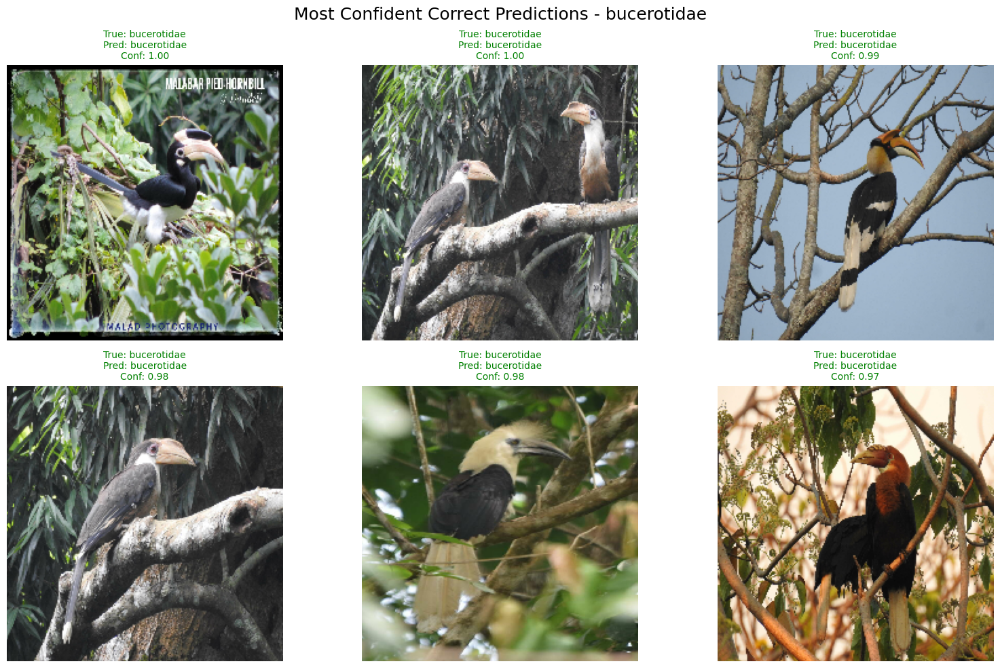

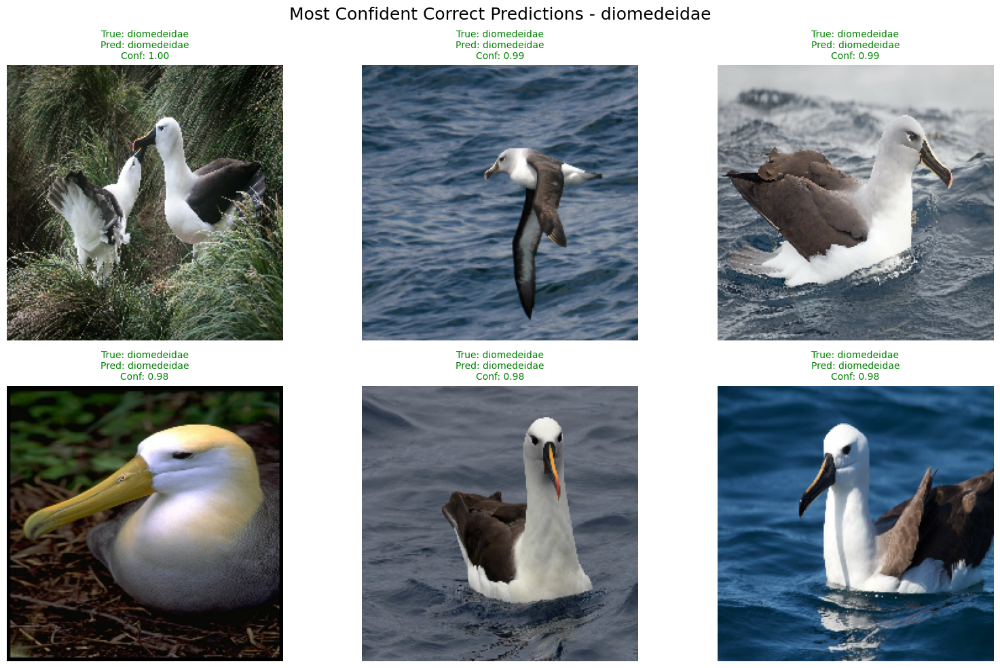

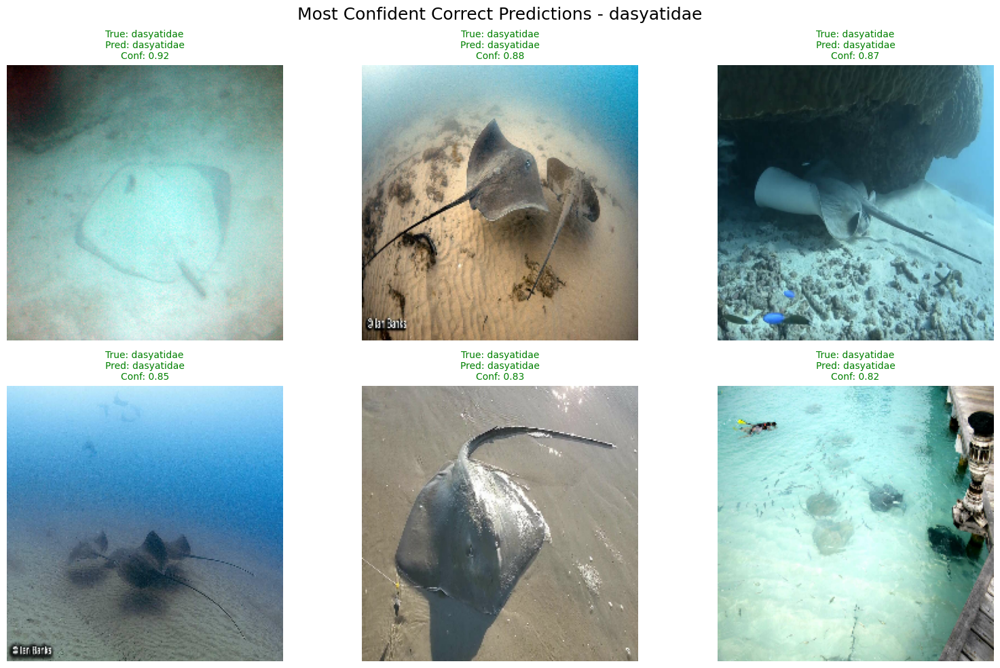

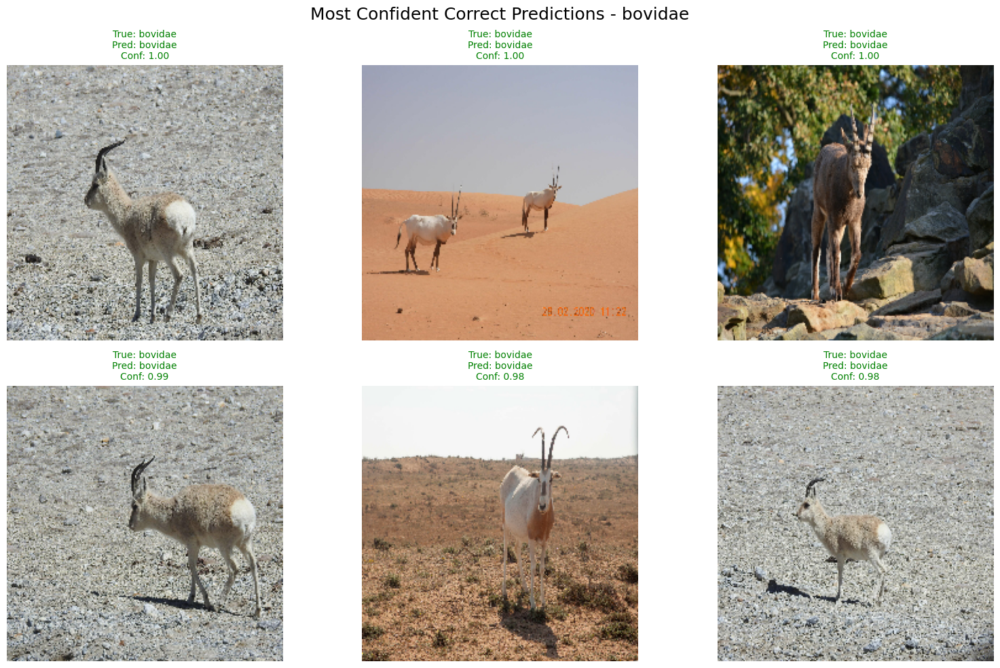

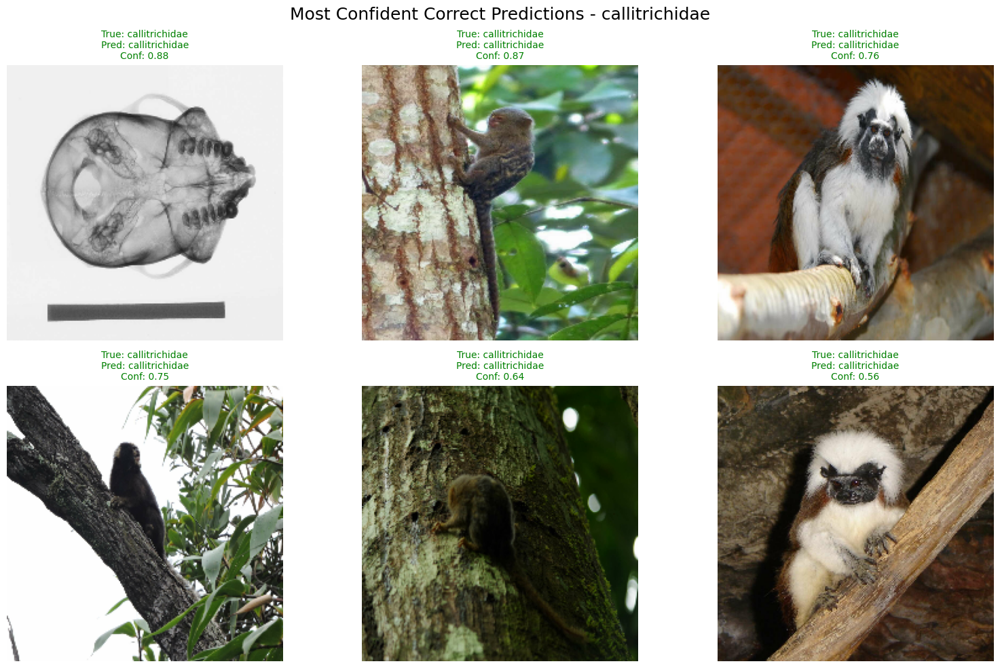

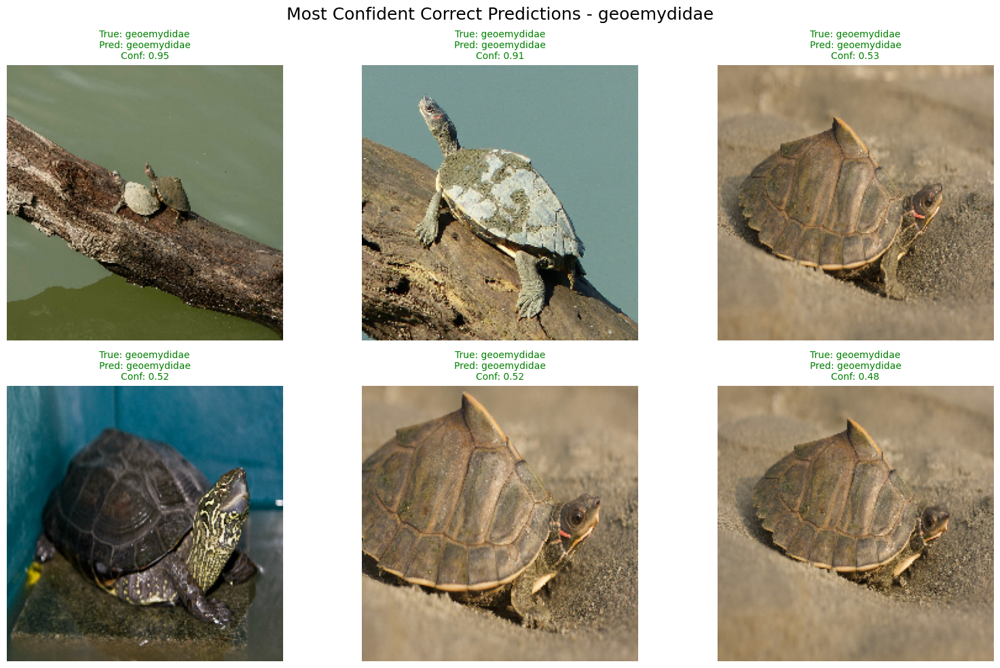

In [99]:
for family in misclassified_data["Predicted Label"]:
    show_correct_predictions_for_family(y_true, y_pred, pred_probs_all, test_images, class_names, family_name=family, num_images=6)

In [100]:
correctly_classified_data

{'True Label': ['apidae',
  'apidae',
  'apidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Predicted Label': ['apidae',
  'apidae',
  'apidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Confidence': [0.9996068,
  0.9995665,
  0.9995208,
  0.9994623,
  0.9994497,
  0.9993734]}

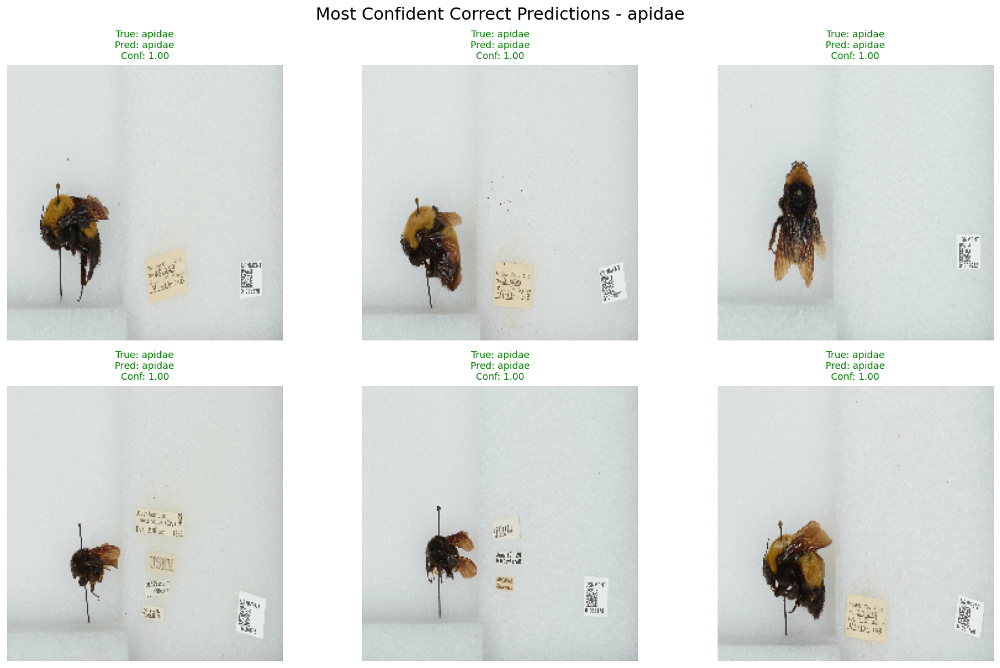

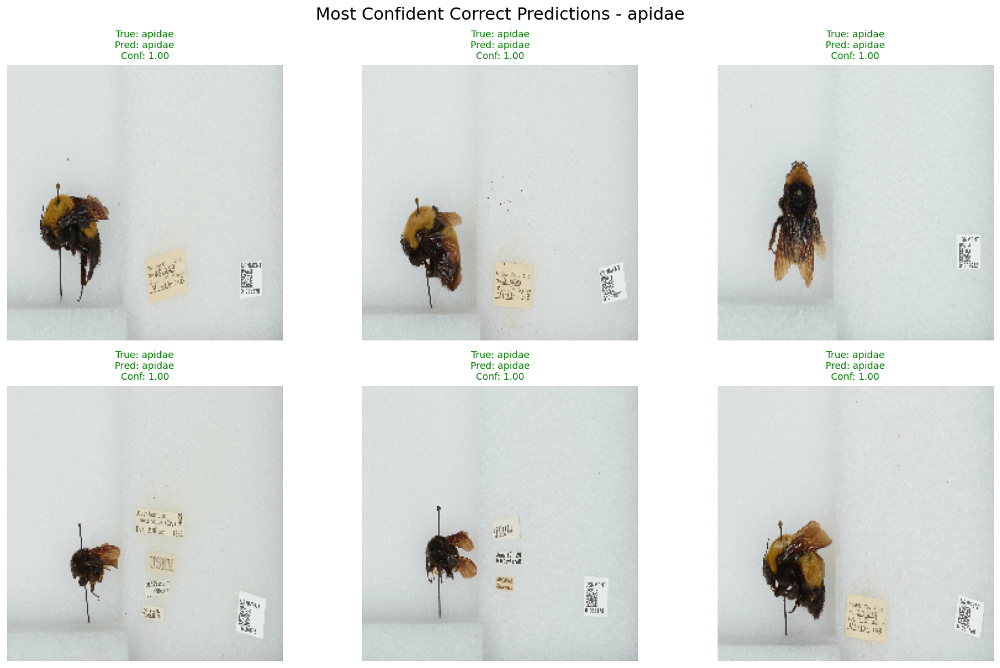

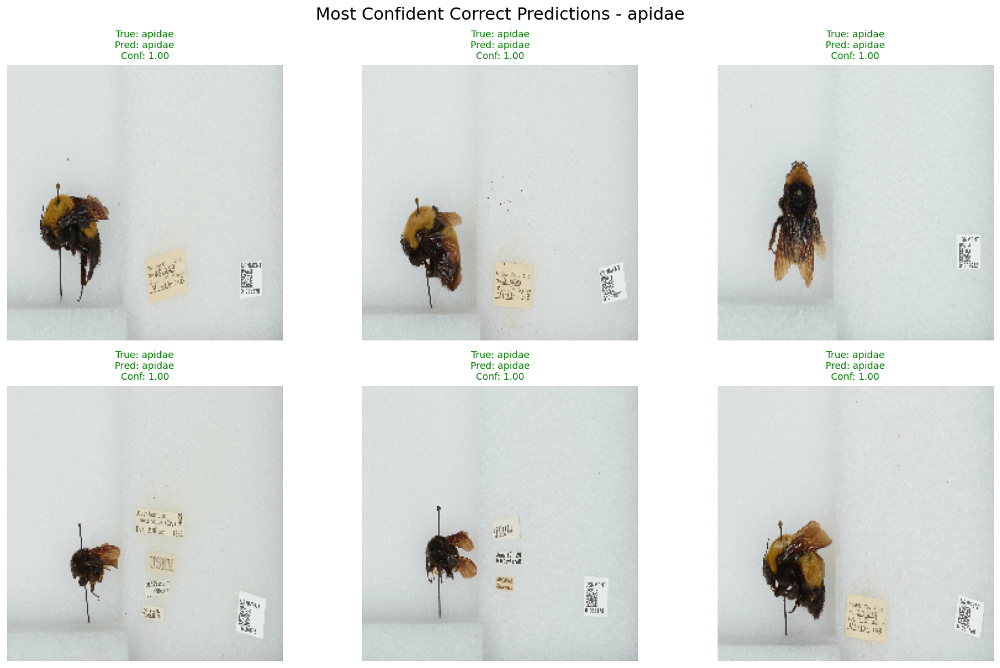

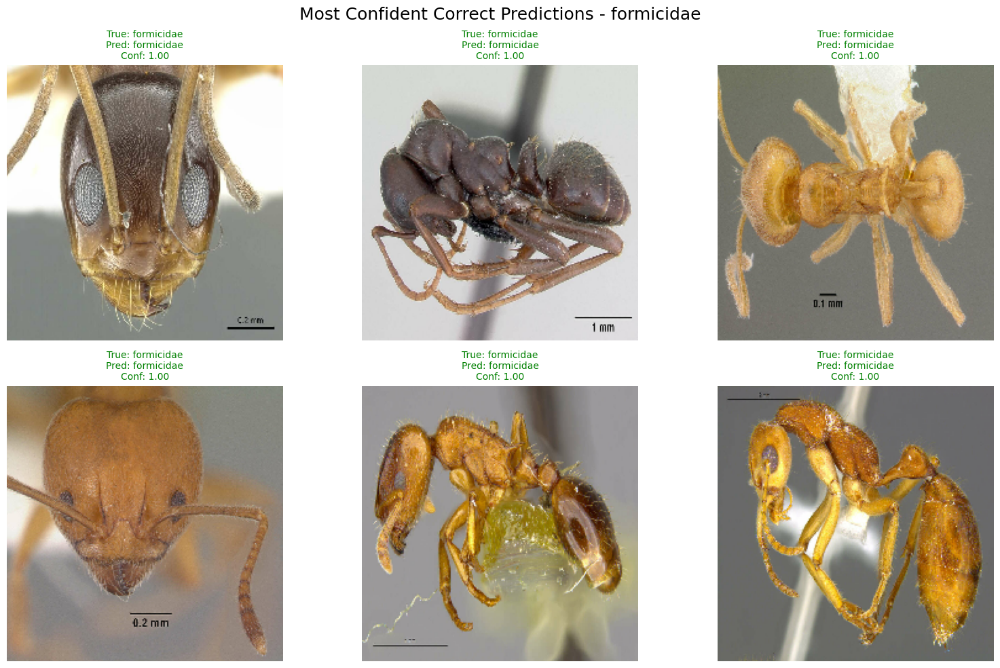

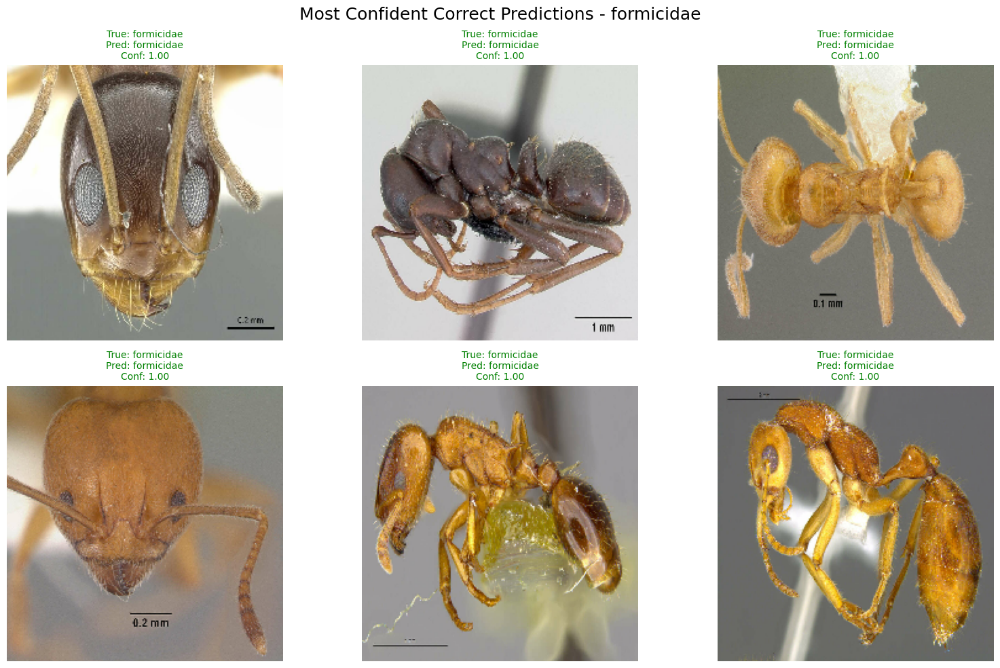

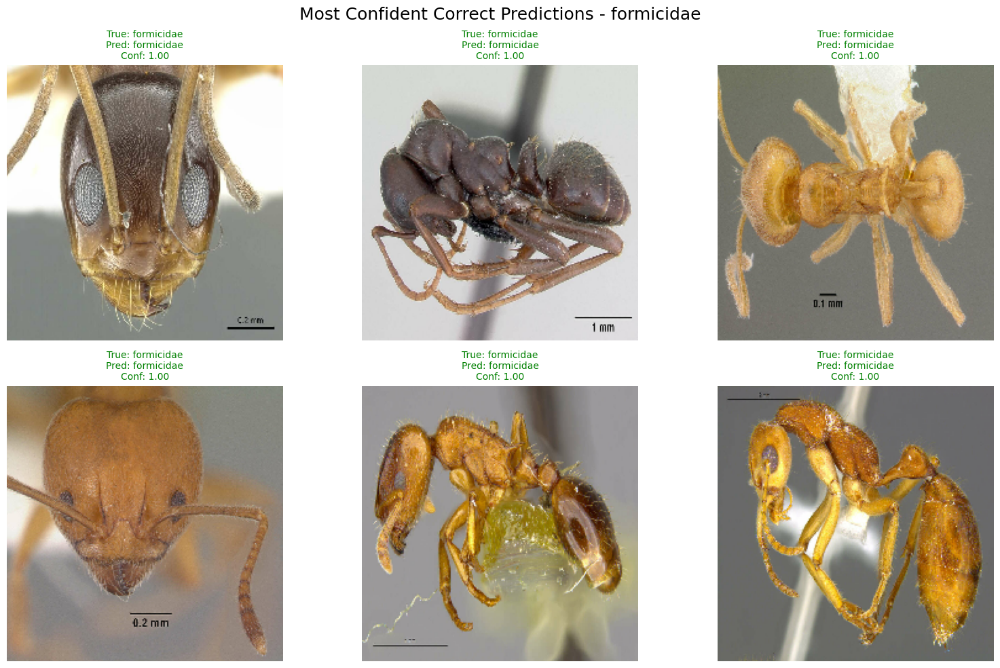

In [101]:
for family in correctly_classified_data["True Label"]:
    show_correct_predictions_for_family(y_true, y_pred, pred_probs_all, test_images, class_names, family_name=family, num_images=6)